<a href="https://colab.research.google.com/github/ksowah/Computer-Vision-Project/blob/main/Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

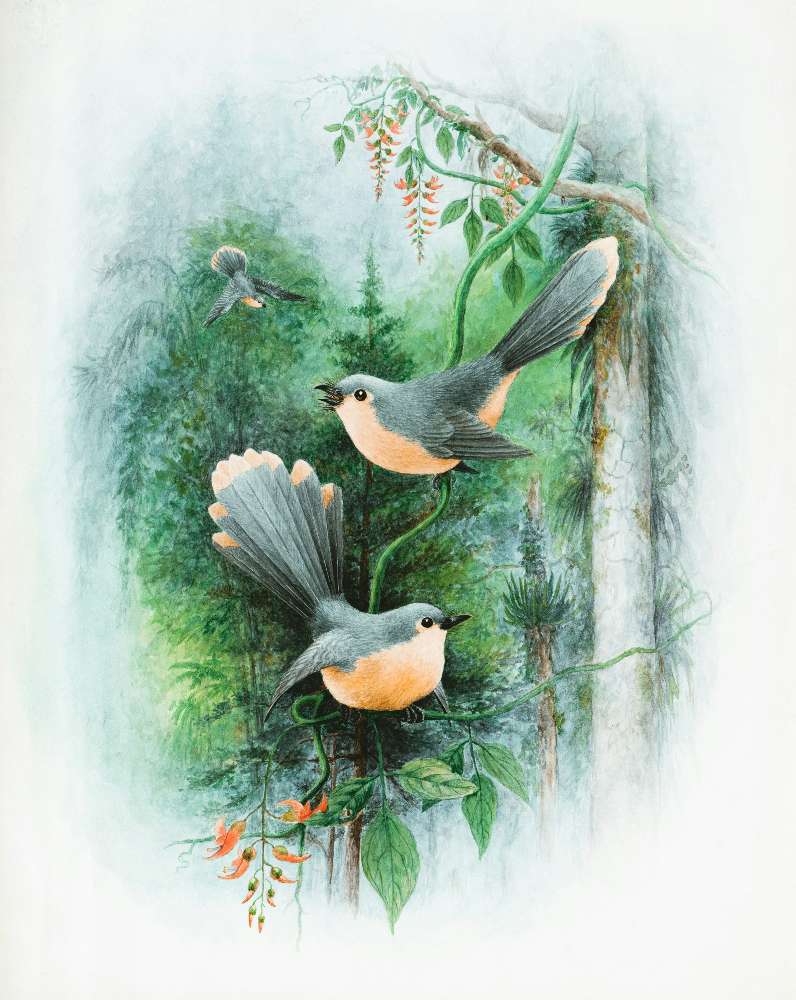

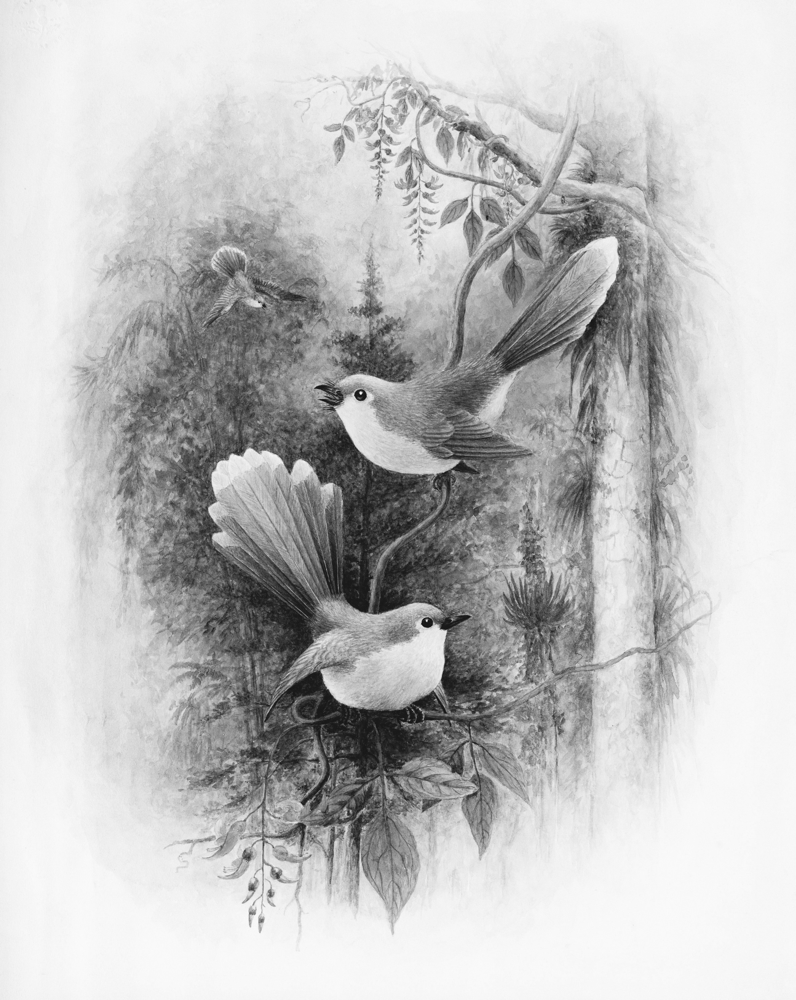

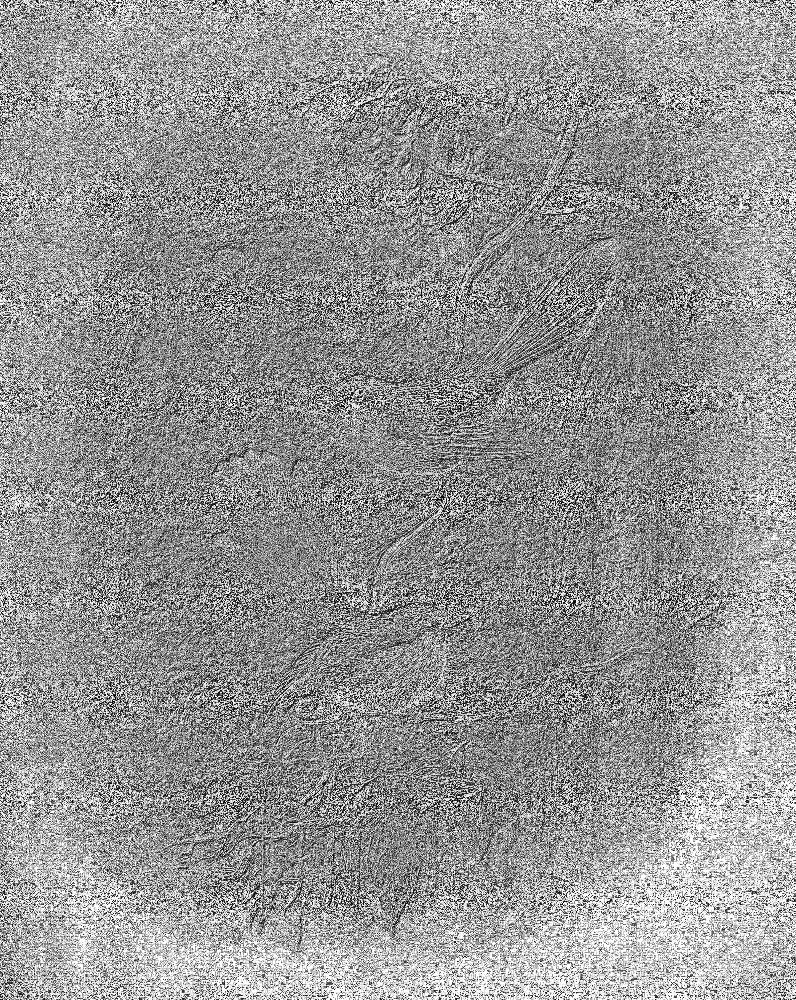

In [ ]:
# prompt: create Local Binary Patterns with cv2

!pip install opencv-python
import cv2
import numpy as np # Import the numpy library
from google.colab.patches import cv2_imshow

def get_pixel(img, center, x, y):
  new_value = 0
  try:
    if img[x][y] >= center:
      new_value = 1
  except:
    pass
  return new_value

def lbp_calculated_pixel(img, x, y):
  '''
   64 | 128 |   1
  ----------------
   32 |   0 |   2
  ----------------
   16 |   8 |   4
  '''
  center = img[x][y]
  val_ar = []
  val_ar.append(get_pixel(img, center, x-1, y+1))     # top_right
  val_ar.append(get_pixel(img, center, x, y+1))       # right
  val_ar.append(get_pixel(img, center, x+1, y+1))     # bottom_right
  val_ar.append(get_pixel(img, center, x+1, y))       # bottom
  val_ar.append(get_pixel(img, center, x+1, y-1))     # bottom_left
  val_ar.append(get_pixel(img, center, x, y-1))       # left
  val_ar.append(get_pixel(img, center, x-1, y-1))     # top_left
  val_ar.append(get_pixel(img, center, x-1, y))       # top

  power_val = [1, 2, 4, 8, 16, 32, 64, 128]
  val = 0
  for i in range(len(val_ar)):
    val += val_ar[i] * power_val[i]
  return val

path = 'art1.jpg'
img_bgr = cv2.imread(path, 1)

# Check if the image was loaded successfully
if img_bgr is None:
    print("Error: Could not load image. Check the file path and permissions.")
else:
    height, width, _ = img_bgr.shape
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

    img_lbp = np.zeros((height, width), np.uint8)
    for i in range(0, height):
        for j in range(0, width):
            img_lbp[i, j] = lbp_calculated_pixel(img_gray, i, j)

    cv2_imshow(img_bgr) # Use cv2_imshow to display images in Colab
    cv2_imshow(img_gray)
    cv2_imshow(img_lbp)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
